# Test holoview library for interactive plot of the EEL sections


Here interactive plot are made on the mean, std, SE EEL section fields, after regridding the sections on a regular spatial grid.

Ongoing Issues and Future improvements:
- [ ] Html file exported from a Holoviz panel with several holo-object doesnt work   ([see here](#hvplot-multipanel))
- [ ] Html file generated with the hv.Image function are big. Is there a way to reproduce hvplot.Contourf using hv.Contours? ([see here](#hv-contours))
- [ ] Edit entry to hover so it also display the distance and the direction to the closest EEL station
- [ ] Link hover between two holoview object or two panel objects ([see here](https://stackoverflow.com/questions/65629074/how-to-link-hovers-of-several-bokeh-holoview-panel-objects-in-python))
- [ ] Test jupyter-lab conversion tool a Voila-gridstack dashboard ([here](https://blog.jupyter.org/dashboarding-with-jupyterlab-3-789fcb1a5857))? (Doesnt seem to work very well with hvplot, see notebook [02-lh-holoview_3_gridded_section_different_typeofplot.ipynb](02-lh-holoview_3_gridded_section_different_typeofplot.ipynb) when _"Open with Voila Gristack"_ is selected ) 


<!-- - [ ] Html file exported from a Holoviz panel with several holo-object doesnt work  (<a href="hvplot-multipanel">[see here]</a>) !-->

___

### Import libraries

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt

#plt.style.use('dark_background')

%matplotlib inline


In [2]:
# Disbale the depreciationwarning from numpy :
# "VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences 
# (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) 
# is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray)""
np.warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)     

#### Variables

In [3]:
pathdir = '../../data/raw/csv_ctdgrid'
pathdatadir = '../../data/raw/csv_datagridded'
colsec = 'royalblue'
colvec = 'salmon'
colellipse = 'limegreen'

## 1. Load and Prep. data

In [4]:
# Define function to load csv file of the gridded statisitcs generated in matlab and convert them in Xarray dataset
def load_EEL_data_in_xarray(EEL2Dfile,pathdir):
    dflad = pd.read_csv(EEL2Dfile,sep=',', index_col=None, 
                             header=0)
    # Sort data format and variable name
    dflad=dflad.round({'PMTP': 4, 'PSAL': 3, 'Sigma0': 3, 'Vrel': 3, 'Vladcp': 3, 'Vabs': 3})
    dflad['Refdist']=dflad['Refdist'].apply(int)
    df2D = dflad.rename(columns={"Refdist": "refdist","Depth": "depth"}).set_index(['refdist','depth']).round(3).sort_values(['refdist','depth'])
    df2D=df2D.rename(columns={"PTMP": "ptmp", "PSAL": "psal", "Sigma0": "sigma0"})
#     print(df2D.info())

    # Import station location metadata
    dfloc = pd.read_csv(pathdir+'/'+'EELCTDandLADCP_refpos.csv',sep=',', index_col=None, 
                         header=0)
    # Make sure the station name are sorted by their distance along the section
    sdfloc = dfloc.rename(columns={"Refdist": "stadist"}).sort_values('stadist', ascending=True)
    sdfloc['stadist']=sdfloc['stadist'].apply(int)
    sdfloc=sdfloc.set_index('stadist')

    # Import cruise (time) metadata
    dfdate = pd.read_csv(pathdir+'/'+'EELCTDandLADCP_refdate.csv',sep=',', index_col=None, 
                         header=0).rename(columns={"Year": "year"}).set_index('year')

    # Convert 2D dataframe into Xarray DataSet
    da0 = df2D.to_xarray()
    daloc = sdfloc.to_xarray()
    dadate = dfdate.to_xarray()

    da=xr.merge([da0, daloc,dadate])
    
    if 'griddednbstafield' not in EEL2Dfile:
        da=da.assign(Vladcp=(da.Vladcp*100),Vrel=(da.Vrel*100),Vabs=(da.Vabs*100))      

    # Add info about the reference EEL station for each grid point:
    grid_dist,_ = xr.broadcast(da.stadist, da.depth)         # Use index instead of staname to interpolate the name of the station on the gridded distance
    grid_ind=grid_dist.interp(stadist=da.refdist,method='nearest')
    grid_name=da.rename({'Staname':'Gridname'}).Gridname.loc[grid_ind].drop_vars('stadist')

    da=xr.merge([da, grid_name])
    return da

In [5]:
# List of file containing data
filedict = {'mean':'EELCTDandLADCP_2Dgriddedmeanfield', 
            'std':'EELCTDandLADCP_2Dgriddedstdfield', 
            'count':'EELCTDandLADCP_2Dgriddednbstafield'
           }

In [6]:
# Load EEL fields mean, std and nb of data into a xarray dataset. Store results in a dictionary
dsdict={}
for key,filename in filedict.items():
    file = pathdatadir+'/'+filename+'.csv'
    dsdict[key]=load_EEL_data_in_xarray(file,pathdir)


In [7]:
# # Test interpolation of station name on the new grid
# grid_ind=grid_dist.interp(stadist=da.refdist,method='nearest')
# grid_name=da.rename({'Staname':'Gridname'}).Gridname.loc[grid_ind].drop_vars('stadist')
# grid_name

In [8]:
# Add a Standard Error dataSet
# # Initialise it from the "count" dataset
import copy
dsdict["SE"] = copy.deepcopy(dsdict["count"])
# # Calculate standard error for list of fields
fieldtup = ('ptmp','psal','sigma0','Vrel','Vladcp','Vabs')
for field in fieldtup:
    dsdict["SE"][field] =  dsdict["std"][field] / (np.sqrt(dsdict["count"][field]))


Using hvplot.interactive (https://hvplot.holoviz.org/user_guide/Interactive.html)

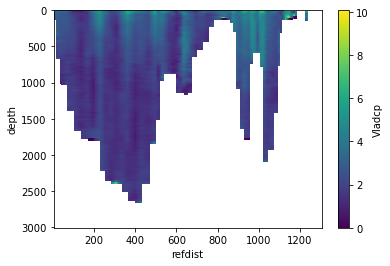

In [9]:
dsdict["SE"].Vladcp.plot(y='depth', yincrease=False)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
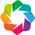

In [10]:
import hvplot.xarray # noqa
import hvplot.pandas # noqa
import panel as pn
import panel.widgets as pnw
import ipywidgets as ipw
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')
pn.extension('bokeh')

## 2. Section plots

Create list of namedtuples for variable to plot on the figure with several subpanels:
The rows of the figure correspond to variable (Temperature, Salinity, Density, Velocity) while the columns correspond to the mean and standard deviation


In [11]:
import collections
fields = [
    'xarray_var',
    'short_name',
    'var_type',
    'contourf_lvls',
    'contour_lvls',    
    'cmap',
    'long_name',
    'cbar_title',
    ]
Datatoplot = collections.namedtuple('Datatoplot',fields,defaults=(None,) * len(fields))

In [12]:
Datatoplot?

Init signature:
Datatoplot(
    xarray_var=None,
    short_name=None,
    var_type=None,
    contourf_lvls=None,
    contour_lvls=None,
    cmap=None,
    long_name=None,
    cbar_title=None,
)
Docstring:      Datatoplot(xarray_var, short_name, var_type, contourf_lvls, contour_lvls, cmap, long_name, cbar_title)
Type:           type
Subclasses:     


##### Definitions of the list of variables to plot with plotting options

In [13]:
# ptmp plots
ptmp_mean = Datatoplot(xarray_var='ptmp', short_name='Mean Pot. Temp.', var_type='mean', 
                      contourf_lvls= np.arange(3, 11, 1),cmap='plasma', 
                      long_name = 'Mean Potential Temperature', cbar_title ='°C')

ptmp_std = Datatoplot(xarray_var='ptmp', short_name='Std Pot. Temp.', var_type='std', 
                      contourf_lvls= np.arange(0, 1.2, 0.2),cmap='OrRd', 
                      long_name = 'Std Potential Temperature', cbar_title ='°C')

ptmp_count = Datatoplot(xarray_var='ptmp', short_name='Count Pot. Temp.', var_type='count', 
                      contourf_lvls= np.arange(-0.5, 17.5, 1),cmap='tab20', 
                      long_name = 'Count Potential Temperature', cbar_title ='')

ptmp_SE = Datatoplot(xarray_var='ptmp', short_name='SE Pot. Temp.', var_type='SE', 
                      contourf_lvls= ptmp_std.contourf_lvls/2,cmap='OrRd', 
                      long_name = 'Standard Error Potential Temperature', cbar_title ='°C')

# psal plots
psal_mean = Datatoplot(xarray_var='psal', short_name='Mean Sal.', var_type='mean', 
                      contourf_lvls= np.arange(34.9, 35.45, 0.05), cmap='viridis', 
                      long_name = 'Mean Salinity', cbar_title =' ')

psal_std = Datatoplot(xarray_var='psal', short_name='Std Sal.', var_type='std', 
                      contourf_lvls= np.arange(0, 0.12, 0.02),cmap='OrRd', 
                      long_name = 'Std Salinity', cbar_title =' ')

psal_count = Datatoplot(xarray_var='psal', short_name='Count Sal.', var_type='count', 
                      contourf_lvls= np.arange(-0.5, 17.5, 1),cmap='tab20', 
                      long_name = 'Count Salinity', cbar_title ='')

psal_SE = Datatoplot(xarray_var='psal', short_name='SE Sal.', var_type='SE', 
                      contourf_lvls= psal_std.contourf_lvls/2,cmap='OrRd', 
                      long_name = 'Standard Error Salinity', cbar_title =' ')

# sigma0 plots
sigma0_mean = Datatoplot(xarray_var='sigma0', short_name='Mean Pot. Dens. Ano.', var_type='mean', 
                      contourf_lvls= np.arange(27.2, 27.9, 0.1), cmap='cividis_r', 
                      long_name = 'Mean Potential Density Anomaly', cbar_title ='kg.m⁻³')

sigma0_std = Datatoplot(xarray_var='sigma0', short_name='Std Pot. Dens. Ano.', var_type='std', 
                      contourf_lvls= np.arange(0, 0.12, 0.02),cmap='OrRd', 
                      long_name = 'Std Potential Density Anomaly', cbar_title ='kg.m⁻³')

sigma0_count = Datatoplot(xarray_var='sigma0', short_name='Count Pot. Dens. Ano.', var_type='count', 
                      contourf_lvls= np.arange(-0.5, 17.5, 1),cmap='tab20', 
                      long_name = 'Count Potential Density Anomaly', cbar_title ='')

sigma0_SE = Datatoplot(xarray_var='sigma0', short_name='SE Pot. Dens. Ano.', var_type='SE', 
                      contourf_lvls= sigma0_std.contourf_lvls/2,cmap='OrRd', 
                      long_name = 'Standard Error Potential Density Anomaly', cbar_title ='kg.m⁻³')

# ladcp plots
ladcp_mean = Datatoplot(xarray_var='Vladcp', short_name='Mean LADCP Vel.', var_type='mean', 
                      contourf_lvls= np.arange(-16, 20, 4), cmap='coolwarm', 
                      long_name = 'Mean cross-section velocity from LADCP', cbar_title ='cm.s⁻¹')

ladcp_std = Datatoplot(xarray_var='Vladcp', short_name='Std LADCP Vel.', var_type='std', 
                      contourf_lvls= np.arange(0, 18, 4), cmap='OrRd', 
                      long_name = 'Std cross-section velocity from LADCP', cbar_title ='cm.s⁻¹')

ladcp_count = Datatoplot(xarray_var='Vladcp', short_name='Count LADCP Vel.', var_type='count', 
                      contourf_lvls= np.arange(-0.5, 17.5, 1),cmap='tab20', 
                      long_name = 'Count cross-section velocity from LADCP', cbar_title ='')

ladcp_SE = Datatoplot(xarray_var='Vladcp', short_name='SE LADCP Vel.', var_type='SE', 
                      contourf_lvls= ladcp_std.contourf_lvls/2, cmap='OrRd', 
                      long_name = 'Standard Error cross-section velocity from LADCP', cbar_title ='cm.s⁻¹')

# relative velocity
vrel_mean = Datatoplot(xarray_var='Vrel', short_name='Mean Rel. Geovel.', var_type='mean', 
                      contourf_lvls= np.arange(-16, 20, 4), cmap='coolwarm', 
                      long_name = 'Mean cross-section geostrophic velocity relative to the bottom', cbar_title ='cm.s⁻¹')

vrel_std = Datatoplot(xarray_var='Vrel', short_name='Std Rel. Geovel.', var_type='std', 
                      contourf_lvls= np.arange(0, 18, 4), cmap='OrRd', 
                      long_name = 'Std cross-section geostrophic velocity relative to the bottom', cbar_title ='cm.s⁻¹')

vrel_count = Datatoplot(xarray_var='Vrel', short_name='Count Rel. Geovel.', var_type='count', 
                      contourf_lvls= np.arange(-0.5, 17.5, 1),cmap='tab20', 
                      long_name = 'Count cross-section geostrophic velocity relative to the bottom', cbar_title ='')

vrel_SE = Datatoplot(xarray_var='Vrel', short_name='SE Rel. Geovel.', var_type='SE', 
                      contourf_lvls= ladcp_std.contourf_lvls/2, cmap='OrRd', 
                      long_name = 'Standard Error cross-section geostrophic velocity relative to the bottom', cbar_title ='cm.s⁻¹')

# absolute geostrophic velocity
vabs_mean = Datatoplot(xarray_var='Vabs', short_name='Mean Abs. Geovel.', var_type='mean', 
                      contourf_lvls= np.arange(-16, 20, 4), cmap='coolwarm', 
                      long_name = 'Mean cross-section absolute geostrophic velocity referenced to LADCP depth-average current', cbar_title ='cm.s⁻¹')

vabs_std = Datatoplot(xarray_var='Vabs', short_name='Std Abs. Geovel.', var_type='std', 
                      contourf_lvls= np.arange(0, 18, 4), cmap='OrRd', 
                      long_name = 'Std ccross-section absolute geostrophic velocity referenced to LADCP depth-average current', cbar_title ='cm.s⁻¹')

vabs_count = Datatoplot(xarray_var='Vabs', short_name='Count Abs. Geovel.', var_type='count', 
                      contourf_lvls= np.arange(-0.5, 17.5, 1),cmap='tab20', 
                      long_name = 'Count cross-section absolute geostrophic velocity referenced to LADCP depth-average current', cbar_title ='')

vabs_SE = Datatoplot(xarray_var='Vabs', short_name='SE Abs. Geovel.', var_type='SE', 
                      contourf_lvls= ladcp_std.contourf_lvls/2, cmap='OrRd', 
                      long_name = 'Standard Error cross-section absolute geostrophic velocity referenced to LADCP depth-average current', cbar_title ='cm.s⁻¹')

# # Create a list of namedtuples
# varstoplot=((ptmp_mean,ptmp_std),
#               (psal_mean,psal_std),
#               (sigma0_mean,sigma0_std),
#               (ladcp_mean,ladcp_std),            
#            )

# Create a dictionnary of namedtuples
vars_dict = { 'ptmp': {'mean': ptmp_mean, 'std':ptmp_std, 'count':ptmp_count, 'SE':ptmp_SE},
              'psal': {'mean': psal_mean, 'std':psal_std, 'count':psal_count, 'SE':psal_SE},
              'sigma0': {'mean': sigma0_mean, 'std':sigma0_std, 'count':sigma0_count, 'SE':sigma0_SE},
              'Vladcp': {'mean': ladcp_mean, 'std':ladcp_std, 'count':ladcp_count, 'SE':ladcp_SE},          
              'Vrel': {'mean': vrel_mean, 'std':vrel_std, 'count':vrel_count, 'SE':vrel_SE},          
              'Vabs': {'mean': vabs_mean, 'std':vabs_std, 'count':vabs_count, 'SE':vabs_SE},                       
            }

### 2.1 With Holoviews 
see more details here [https://hvplot.holoviz.org/reference/xarray/contourf.html#xarray-gallery-contourf]

In [14]:
from bokeh.resources import INLINE
from bokeh.models import HoverTool
from bokeh.models import CustomJSHover

In [15]:
data = vars_dict['ptmp']['mean']
if data.var_type == 'mean':
    xrdata = dsdict['mean']
elif data.var_type == 'std':
    xrdata = dsdict['std'] 
else:
    raise ValueError(f"Wrong var_type in: {data}")

To "transform" the depth coordinate use the `transform` option (https://github.com/holoviz/hvplot/issues/497)

In [16]:
#hv.help(xrdata.hvplot.image())

#### 2.1.1 using image (NOT WORKING PROPERLY IF HORIZONTAL GRID IS NOT REGULAR) 
<div class="alert alert-block alert-warning"> <b>Image method is only working for regular 2D grid</b>

In [17]:
from bokeh.models import HoverTool
MyImageHover = HoverTool(
    tooltips=[
        ( 'refdist', '$x{%4.0f} km'),
        ( 'depth', '$y{%4.0f} m'),
        ( 'ptmp', '@image{%1.3f} degC'),
        ( 'psal', '@psal{%1.3f} '),        
   ],
    formatters={
        '$x' : 'printf',
        '$y' : 'printf',
        '@image' : 'printf',
        '@psal' : 'printf',        
    },
    point_policy="follow_mouse"
)

In [18]:
# hv.help(xrdata.hvplot.image)

In [19]:
hv_label = '°C'
reversedepth = - hv.dim('depth')
plot=xrdata.hvplot.image(x='refdist',y='depth',z=data.xarray_var,
                                    transforms=dict(depth=reversedepth),
                                    clim=(data.contourf_lvls.min(),data.contourf_lvls.max()),                  
                                    cmap=data.cmap,
                                    clabel=hv_label, 
                                    label=data.long_name,
                                    )

plot.opts(opts.Image(tools=[MyImageHover]))


:Image   [refdist,depth]   (ptmp)

##### Try to use Holoview Holomap object to add several dimensions to hover


In [20]:
list_var=list(vars_dict.keys())


def make_EEL_sec(data):
    xrdata = dsdict[data.var_type]
    plot=hv.Image(xrdata, kdims=['refdist','depth'],
                    vdims=[data.xarray_var] + list_var,
                    label=data.long_name,
                   ).opts(colorbar=True,clim=(data.contourf_lvls.min(),data.contourf_lvls.max()),                  
                                        cmap=data.cmap,
                                        clabel=data.cbar_title,
                                        )
    return plot
# curve_dict_2D = {(p,f):sine_curve(p,f) for p in phases for f in frequencies}

hv_img={(data[1].xarray_var,data[1].var_type):make_EEL_sec(data[1]) for vardict in list(vars_dict.items())[:3] for data in list(vardict[1].items())[:2] }


MyHoloHover = HoverTool(
    tooltips=[
        ( 'refdist', '$x{%4.0f} km'),
        ( 'depth', '$y{%4.0f} m'),
        ( 'ptmp', '@ptmp{%1.3f} degC'),
        ( 'psal', '@psal{%1.3f} '),     
        ( 'sigma0', '@sigma0{%1.3f} kg/m3'),
        ( 'Vladcp', '@Vladcp{%2.1f} cm/s'),             
   ],
    formatters={
        '$x' : 'printf',
        '$y' : 'printf',
        '@ptmp' : 'printf',
        '@psal' : 'printf',   
        '@sigma0' : 'printf',
        '@Vladcp' : 'printf',           
    },
    point_policy="follow_mouse"
)
hmap = hv.HoloMap(hv_img, kdims=['variable', 'stats']).opts(width=600,tools = [MyHoloHover])

panel_Object = pn.pane.HoloViews(hmap)
panel_Object.save('test_holomap.html', resources=INLINE, title = 'Hover Example', embed=True)
panel_Object

HoloViews(HoloMap)

In [21]:
# hv.help(hv_img)

In [22]:
dsdict["mean"]

<xarray.Dataset>
Dimensions:   (depth: 301, refdist: 260, stadist: 69, year: 17)
Coordinates:
  * refdist   (refdist) int64 7 12 17 22 27 32 ... 1277 1282 1287 1292 1297 1302
  * depth     (depth) int64 5 15 25 35 45 55 ... 2955 2965 2975 2985 2995 3005
  * stadist   (stadist) int64 0 13 25 55 84 122 ... 1277 1286 1292 1298 1307
  * year      (year) int64 1996 1997 1998 1999 2000 ... 2013 2014 2015 2016 2017
Data variables:
    ptmp      (refdist, depth) float64 9.819 9.353 9.167 8.97 ... nan nan nan
    psal      (refdist, depth) float64 34.93 35.03 35.09 35.12 ... nan nan nan
    sigma0    (refdist, depth) float64 26.91 27.08 27.15 27.21 ... nan nan nan
    Vrel      (refdist, depth) float64 -2.1 0.1 0.2 0.3 0.4 ... nan nan nan nan
    Vladcp    (refdist, depth) float64 -2.0 -1.4 -1.2 -0.5 ... nan nan nan nan
    Vabs      (refdist, depth) float64 3.9 0.4 0.4 0.5 0.7 ... nan nan nan nan
    Staname   (stadist) object 'IB23S' 'IB22S' 'IB21S' ... '3G' '2G' '1G'
    LonSta    (stadist) float64 -20.21 -20.07 -19.92 ... -6.367 -6.283 -6.133
    LatSta    (stadist) float64 63.32 63.22 63.13 62.92 ... 56.71 56.68 56.67
    DepthSta  (stadist) int64 120 670 1030 1400 1670 1790 ... 80 115 70 30 190
    CruiseID  (year) object 'd22396' 'd23097' 'd23398' ... 'dy052' 'dy078'
    Month     (year) int64 10 9 5 9 2 2 10 10 8 6 5 5 5 7 6 6 5
    Gridname  (refdist, depth) object 'IB22S' 'IB22S' 'IB22S' ... '2G' '2G' '2G'

##### Try other way of plotting using holoview Image

See this example: https://docs.bokeh.org/en/latest/docs/user_guide/tools.html#image-hover

In [23]:


list_var=list(vars_dict.keys())
list(list(vars_dict.items())[0][1].items())[0][1]

def make_EEL_sec(data):
    xrdata = dsdict[data.var_type]
    xrdata=xrdata.assign_coords(depth=(-xrdata.depth))
    plot=hv.Image(xrdata, kdims=['refdist','depth'],
                    vdims= [data.xarray_var] + list_var + ['Gridname'],
                    label=data.long_name,
                   )
    
    plot.opts(colorbar=True,clim=(data.contourf_lvls.min(),data.contourf_lvls.max()),                  
                                        cmap=data.cmap,
                                        clabel=data.cbar_title,
                                        )
    print(f" {data.contourf_lvls.min()}  ---  {data.contourf_lvls.max()}")
    

    MyHoloHover = HoverTool(
        tooltips=[
            ( 'Closest EEL Station', '@Gridname'),           
            ( 'refdist', '$x{%4.0f} km'),
            ( 'depth', '$y{%4.0f} m'),
            ( 'ptmp', '@ptmp{%1.3f} degC'),
            ( 'psal', '@psal{%1.3f} '),     
            ( 'sigma0', '@sigma0{%1.3f} kg/m3'),
            ( 'Vladcp', '@Vladcp{%2.1f} cm/s'),             
       ],
        formatters={
            '@Gridname' : 'printf',            
            '$x' : 'printf',
            '$y' : 'printf',
            '@ptmp' : 'printf',
            '@psal' : 'printf',   
            '@sigma0' : 'printf',
            '@Vladcp' : 'printf',           
        },
        point_policy="follow_mouse"    
    )
    
    plot.opts(width=600,tools = [MyHoloHover])
        
    return plot

make_EEL_sec(vars_dict['psal']['mean'])



 34.9  ---  35.44999999999997


:Image   [refdist,depth]   (psal,ptmp,psal,sigma0,Vladcp,Vrel,Vabs,Gridname)

#### 2.1.2 using quadmesh

In [24]:
data = vars_dict['ptmp']['mean']
if data.var_type == 'mean':
    xrdata = dsdict['mean']
elif data.var_type == 'std':
    xrdata = dsdict['std'] 
else:
    raise ValueError(f"Wrong var_type in: {data}")

In [25]:
MyQuadmeshHover = HoverTool(
    tooltips=[
        ( 'refdist', '$x{%4.0f} km'),
        ( 'depth', '$y{%4.0f} m'),
        ( 'ptmp', '@'+ data.xarray_var +'{%1.3f} degC'),
   ],
    formatters={
        '$x' : 'printf',
        '$y' : 'printf',
        '@'+ data.xarray_var : 'printf',
    },
    point_policy="follow_mouse"
)
# quadmesh test
plot2=xrdata.hvplot.quadmesh(x='refdist',y='depth',z=data.xarray_var,
                                    transforms=dict(depth=reversedepth),
                                    clim=(data.contourf_lvls.min(),data.contourf_lvls.max()),                  
                                    cmap=data.cmap,
                                    clabel=hv_label, 
                                    label=data.long_name,
                                    )
plot2.opts(tools=[MyQuadmeshHover])

:QuadMesh   [refdist,depth]   (ptmp)


#### 2.1.3 using contour

In [26]:
hv_label = '°C'
reversedepth = - hv.dim('depth')
cont=xrdata.hvplot.contour(z=data.xarray_var, x='refdist', y='depth',
                                    transforms=dict(depth=reversedepth),
                                    levels=data.contourf_lvls,
                                    cmap=data.cmap,
                                    clabel=hv_label, 
                                    label=data.long_name)


cont

:Contours   [refdist,depth]   (ptmp)

<a id='hv-contours'></a>
##### Try other way of plotting using holoview Contours

See this example: https://stackoverflow.com/a/54681316/13890678

#### 2.1.4 using contourf

In [27]:
# Hover setup

MyHover = HoverTool(
    tooltips=[
        ( 'x', '$x'),
        ( 'y', '$y'),
        ( 'ptmp', '@ptmp{%1.3f} degC'),
        ( 'psal', '@psal{%1.3f} '),        
   ],
    formatters={
        '$x' : 'numeral',
        '$y' : 'numeral',
        '@ptmp' : 'printf',
        '@psal' : 'printf',        
    },
    point_policy="follow_mouse"
)

hv_label = '°C'
reversedepth = - hv.dim('depth')
contf=xrdata.hvplot.contourf(z=data.xarray_var, x='refdist', y='depth',
                                    transforms=dict(depth=reversedepth),
                                    levels=data.contourf_lvls,
                                    cmap=data.cmap,
                                    clabel=hv_label, 
                                    label=data.long_name,
                             )


contf.opts(tools = [MyHover])

:Polygons   [refdist,depth]   (ptmp)

##### Try to add several variable on same hover using hvplot

In [28]:
xrdata

<xarray.Dataset>
Dimensions:   (depth: 301, refdist: 260, stadist: 69, year: 17)
Coordinates:
  * refdist   (refdist) int64 7 12 17 22 27 32 ... 1277 1282 1287 1292 1297 1302
  * depth     (depth) int64 5 15 25 35 45 55 ... 2955 2965 2975 2985 2995 3005
  * stadist   (stadist) int64 0 13 25 55 84 122 ... 1277 1286 1292 1298 1307
  * year      (year) int64 1996 1997 1998 1999 2000 ... 2013 2014 2015 2016 2017
Data variables:
    ptmp      (refdist, depth) float64 9.819 9.353 9.167 8.97 ... nan nan nan
    psal      (refdist, depth) float64 34.93 35.03 35.09 35.12 ... nan nan nan
    sigma0    (refdist, depth) float64 26.91 27.08 27.15 27.21 ... nan nan nan
    Vrel      (refdist, depth) float64 -2.1 0.1 0.2 0.3 0.4 ... nan nan nan nan
    Vladcp    (refdist, depth) float64 -2.0 -1.4 -1.2 -0.5 ... nan nan nan nan
    Vabs      (refdist, depth) float64 3.9 0.4 0.4 0.5 0.7 ... nan nan nan nan
    Staname   (stadist) object 'IB23S' 'IB22S' 'IB21S' ... '3G' '2G' '1G'
    LonSta    (stadist) float64 -20.21 -20.07 -19.92 ... -6.367 -6.283 -6.133
    LatSta    (stadist) float64 63.32 63.22 63.13 62.92 ... 56.71 56.68 56.67
    DepthSta  (stadist) int64 120 670 1030 1400 1670 1790 ... 80 115 70 30 190
    CruiseID  (year) object 'd22396' 'd23097' 'd23398' ... 'dy052' 'dy078'
    Month     (year) int64 10 9 5 9 2 2 10 10 8 6 5 5 5 7 6 6 5
    Gridname  (refdist, depth) object 'IB22S' 'IB22S' 'IB22S' ... '2G' '2G' '2G'

In [29]:
# xrdata.hvplot.image(z=['ptmp','psal'])

##### Got and error using the xarray dataset but simple example seems to be working (https://discourse.holoviz.org/t/how-to-add-an-extra-variable-to-hover-on-image-or-contourf-plot/1664)

Let's try on a new dataset containing only the desirable variable


In [30]:
newdataset = xr.Dataset(
    {
        "ptmp": (["refdist", "depth"], xrdata.ptmp),
        "psal": (["refdist", "depth"], xrdata.psal),
    },
    coords={
        "refdist": ("refdist", xrdata.refdist),
        "depth": ("depth", xrdata.depth),
    },
)
newdataset.hvplot.image(z=['ptmp','psal'],hover_cols=['ptmp','psal'])

:DynamicMap   [Variable]
   :Image   [depth,refdist]   (ptmp,ptmp,psal)

##### Same example but with more options 

In [31]:
listofvar_to_plot = ['ptmp','psal']

MyHover = HoverTool(
    tooltips=[
        ( 'x', '$x'),
        ( 'y', '$y'),
        ( 'ptmp', '@ptmp{%1.3f} degC'),
        ( 'psal', '@psal{%1.3f} '),        
   ],
    formatters={
        '$x' : 'numeral',
        '$y' : 'numeral',
        '@ptmp' : 'printf',
        '@psal' : 'printf',        
    },
    point_policy="snap_to_data" #"follow_mouse"
)

hv_label = '°C'
reversedepth = - hv.dim('depth')
contf=newdataset.hvplot.contourf(z=listofvar_to_plot, x='refdist', y='depth',
                                    hover_cols=listofvar_to_plot,
                                    transforms=dict(depth=reversedepth),
                                    levels=data.contourf_lvls,
                                    cmap=data.cmap,
                                    clabel=hv_label, 
                                    label=data.long_name,
                             )


contf.opts(tools = [MyHover])

:DynamicMap   [Variable]
   :Polygons   [refdist,depth]   (ptmp)


#### 2.1.3 Create overlay layers

More information on how to overlay plots [[here]](http://holoviews.org/user_guide/Composing_Elements.html)

##### Bathymetry section:

In [32]:
X  = xrdata['stadist']
Y  = -xrdata['DepthSta']
Y2 = -2900*np.ones(Y.shape)
areaplot = hv.Area((X, Y, Y2), vdims=['y', 'y2'])

In [33]:
areaplot

:Area   [x]   (y,y2)


##### Station locations:

In [34]:
# Add vertical lines correpsonding to stations location
loc = [(x, -1500, 1520) for x in xrdata['stadist']]
vlines = hv.ErrorBars(loc)

##### Contour of specific water mass:

In [35]:
c_WM = [27.20,27.50,27.70,27.85]
cmap_WM = 'Cividis'; #['#000000']
contWM=xrdata.hvplot.contour(z='sigma0', x='refdist', y='depth',
                                    transforms=dict(depth=reversedepth),
                                    levels=c_WM,
#                                     cmap=['#000000'],
                                     cmap=cmap_WM,
                                     line_width=2,
                                    colorbar = False,
                             )
contWM

:Contours   [refdist,depth]   (sigma0)

In [36]:
# hv.help(contWM)


#### 2.1.4 Merge overlay layers

In [37]:
# Overlay both plots
overlay_section = (areaplot * contf * vlines * contWM)

overlay_section.opts(
    hv.opts.Area(fill_color='saddlebrown'),
    hv.opts.ErrorBars(color='grey', line_width=1, lower_head=None,upper_head=None),
)

overlay_section.opts(ylim=(-3000, 10),
                     legend_position='bottom_right',
                     legend_opts = {'title':'Pot. Density Contour (kg.m⁻³)',
                                    'orientation':'horizontal'})


:DynamicMap   [Variable]
   :Overlay
      .Area.I                              :Area   [x]   (y,y2)
      .Polygons.Mean_Potential_Temperature :Polygons   [refdist,depth]   (ptmp)
      .ErrorBars.I                         :ErrorBars   [x]   (y,yerror)
      .Contours.I                          :Contours   [refdist,depth]   (sigma0)

### 2.2 With HoloViz Panel 
- See more details on Holoviz Panel [[here]](https://panel.holoviz.org/gallery/index.html)
- See more infos on Bokeh Colormap [[here]](https://docs.bokeh.org/en/latest/docs/reference/palettes.html)
- **More on how to manipulate Matplotlib colormap [[here]](https://matplotlib.org/3.3.3/tutorials/colors/colormap-manipulation.html)** 


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
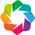

In [38]:
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')

import panel as pn
import panel.widgets as pnw
pn.extension()

from bokeh.palettes import all_palettes
# import bokeh.palettes as palettes
# from bokeh.models import LinearColorMapper

# Import matplotlib colormaps
from matplotlib import cm
# viridis = cm.get_cmap('viridis', 8)
# viridis.colors



In [39]:
data_nametuple = vars_dict['ptmp']['mean']
data_nametuple

Datatoplot(xarray_var='ptmp', short_name='Mean Pot. Temp.', var_type='mean', contourf_lvls=array([ 3,  4,  5,  6,  7,  8,  9, 10]), contour_lvls=None, cmap='plasma', long_name='Mean Potential Temperature', cbar_title='°C')

In [40]:
xrdata = dsdict["count"]

#### 2.2.1 Using hvplot

In [41]:

vel_var=["Vladcp","Vrel","Vabs"]

Useful guide about hover formatting here: https://docs.bokeh.org/en/latest/docs/user_guide/tools.html#formatting-tooltip-fields


For tale of unicode character, go there: https://en.wikipedia.org/wiki/List_of_Unicode_characters#Superscripts_and_Subscripts

##### A. Single panel

In [42]:
def plot_section(var_name, stats_type='mean', plot_type='contourf'):
    """
    Filled contour plot of the mean or standard deviation EEL section.

    Arguments
    ---------
    var_name: string
        Choose between ptmp, psal, sigma0, Vladcp
    stats_type: string
        Choose between mean, std, count, or SE
    plot_type: string
        Choose between image, contourf, quadmesh
    Returns
    -------
    obj : HoloViews object
        The HoloViews representation of the plot.
    """
    
    data_nametuple = vars_dict[var_name][stats_type]
    xrdata = dsdict[stats_type]
        
    # plot contourf
    reversedepth = - hv.dim('depth')
    contf=xrdata.hvplot.contourf(z=data_nametuple.xarray_var, x='refdist', y='depth',
                                        transforms=dict(depth=reversedepth),
                                        levels=data_nametuple.contourf_lvls,
                                        cmap=data_nametuple.cmap,
                                        clabel=data_nametuple.cbar_title, 
                                        label=data_nametuple.long_name,
                                        )

    

    if var_name in ["Vladcp","Vrel","Vabs"]:
    
        # Hover
        MyHover = HoverTool(
            tooltips=[
                ( 'Distance from Iceland', ' $x{%4.0f} km'),
                ( 'Depth', ' $y{%4.0f} m'),
                ( data_nametuple.short_name, '@' + data_nametuple.xarray_var + '{%2.1f} ' + data_nametuple.cbar_title),
           ],
            formatters={
                '$x' : 'printf',
                '$y' : 'printf',
                '@' + data_nametuple.xarray_var : 'printf',
            },
            point_policy="follow_mouse"
        )
    else:
        # Hover
        MyHover = HoverTool(
            tooltips=[
                ( 'Distance from Iceland', ' $x{%4.0f} km'),
                ( 'Depth', ' $y{%4.0f} m'),
                ( data_nametuple.short_name, '@' + data_nametuple.xarray_var + '{%2.3f} ' + data_nametuple.cbar_title),
           ],
            formatters={
                '$x' : 'printf',
                '$y' : 'printf',
                '@' + data_nametuple.xarray_var : 'printf',
            },
            point_policy="follow_mouse"
        )
    
    
    contf.opts(tools = [MyHover])
    
    # add bathymetry
    X  = xrdata['stadist']
    Y  = -xrdata['DepthSta']
    Y2 = -2900*np.ones(Y.shape)
    areaplot = hv.Area((X, Y, Y2), vdims=['y', 'y2'])

    # Add vertical lines correpsonding to stations location
    loc = [(x, -1500, 1520) for x in xrdata['stadist']]
    vlines = hv.ErrorBars(loc)
  
    # Add density contour for water masses
    c_WM = [27.20,27.50,27.70,27.85]
    if var_name == 'ptmp' and stats_type == 'mean':
        cmap_WM = all_palettes['Greens'][5]#[::-1]
    elif var_name in ['psal','sigma0'] and stats_type == 'mean':
        cmap_WM = all_palettes['Reds'][6][:-1]
    else:
        cmap_WM = all_palettes['Viridis'][6][:-1];  #['#000000']        
        
    contWM=dsdict['mean'].hvplot.contour(z='sigma0', x='refdist', y='depth',
                                        transforms=dict(depth=reversedepth),
                                        levels=c_WM,
                                        cmap=cmap_WM,
                                        line_width=2,
                                        colorbar = False,
                                 )
 

    # Overlay both plots
    overlay_section = (areaplot * contf * vlines * contWM)

    overlay_section.opts(
        hv.opts.Area(fill_color='saddlebrown'),
        hv.opts.ErrorBars(color='grey', line_width=1, lower_head=None,upper_head=None),
    )

    overlay_section.opts(width=800,ylim=(-3000, 10),
                     legend_position='bottom_right',
                     legend_opts = {'title':'Pot. Density Contour (kg.m⁻³)',
                                    'orientation':'horizontal'}
    )

    return overlay_section

In [43]:

variable_type = ('ptmp', 'psal', 'sigma0','Vladcp')

variables  = pnw.Select(name='Variable', value='ptmp', 
                                 options=list(variable_type))

stats_type = ('mean', 'std', 'count','SE')

stats  = pnw.RadioButtonGroup(name='Statistic', value='mean', 
                                 options=list(stats_type))

@pn.depends(variables,stats)
def reactive_section(variables,stats):
    return plot_section(variables, stats_type=stats)

widgets   = pn.Column(variables,stats)

# The widget buttons don't work when plotting mean section on top of std section
section_pn2 = pn.Column("<br>\n# EEL section",pn.Row(reactive_section,widgets)
                      )

#section_pn.show()
section_pn2

Column
    [0] Markdown(str)
    [1] Row
        [0] ParamFunction(function)
        [1] Column
            [0] Select(name='Variable', options=['ptmp', 'psal', ...], value='ptmp')
            [1] RadioButtonGroup(name='Statistic', options=['mean', 'std', ...], value='mean')

In [44]:
# # Export into static html file: 
# section_pn2.save(htmldir + '02_section_panel_double_selector.html', embed=True)

<a id='hvplot-multipanel'></a>
##### B. With several subpanels


In [45]:

variable_type = ('ptmp', 'psal', 'sigma0','Vladcp')

variables  = pnw.RadioButtonGroup(name='Variable', value='ptmp', 
                                 options=list(variable_type))

@pn.depends(variables)
def reactive_mean_section(variables):
    return plot_section(variables)

@pn.depends(variables)
def reactive_std_section(variables):
    return plot_section(variables, stats_type='std')

@pn.depends(variables)
def reactive_count_section(variables):
    return plot_section(variables, stats_type='count')

@pn.depends(variables)
def reactive_SE_section(variables):
    return plot_section(variables, stats_type='SE')

widgets   = pn.Column("<br>\n# EEL section", variables)

# The widget buttons don't work when plotting mean section on top of std section
section_pn = pn.Column(widgets,pn.Column(reactive_mean_section,
                                         reactive_std_section,
                                         reactive_count_section,
                                         reactive_SE_section,)
                      )

#section_pn.show()
section_pn


Column
    [0] Column
        [0] Markdown(str)
        [1] RadioButtonGroup(name='Variable', options=['ptmp', 'psal', ...], value='ptmp')
    [1] Column
        [0] ParamFunction(function)
        [1] ParamFunction(function)
        [2] ParamFunction(function)
        [3] ParamFunction(function)

In [46]:
# Export into static html file: 
from bokeh.resources import INLINE
htmldir='html/'
section_pn.save(htmldir + '02_section_multiplepanel_2.html',resources=INLINE, embed=True)


##### **! Interactivity doesnt work once file is exported !**
Issue opened related to this problem on Github: https://github.com/holoviz/panel/issues/1886


#### 2.2.2 Using holoview

but doesnt work for contourf (the holoview.Contours function is different [(see here)](http://holoviews.org/reference/elements/bokeh/Contours.html))


In [47]:
def plot_holoview_section(var_name, stats_type='mean'):
    """
    Filled contour plot of the mean or standard deviation EEL section.

    Arguments
    ---------
    var_name: string
        Choose between ptmp, psal, sigma0, Vladcp
    stats_type: string
        Choose between mean, std, count, or SE
    Returns
    -------
    obj : HoloViews object
        The HoloViews representation of the plot.
    """
    list_var = list(vars_dict.keys())
    
    data_nametuple = vars_dict[var_name][stats_type]
    xrdata = dsdict[data_nametuple.var_type]
    
    # Minimal changes to the xarray dataset
    xrdata=xrdata.assign_coords(depth=(-xrdata.depth)) 
    plot=hv.Image(xrdata, kdims=['refdist','depth'],
                    vdims= [data_nametuple.xarray_var] + list_var + ['Gridname'],
                    label=data_nametuple.long_name,
                   )
    
    if stats_type != 'count':
        contour_nb = (len(data_nametuple.contourf_lvls) -1)*2
        custom_cmap = cm.get_cmap(data_nametuple.cmap, contour_nb) 
    else:
        custom_cmap = data_nametuple.cmap
    
    plot.opts(colorbar=True,clim=(data_nametuple.contourf_lvls.min(),data_nametuple.contourf_lvls.max()),                  
#                                         cmap=data_nametuple.cmap,
                                        cmap=custom_cmap,
                                        clabel=data_nametuple.cbar_title,
                                        )
    
#     MyCustomVelocity = CustomJSHover(code='''
#             var value;
#             var modified;
#             modified = value *100;
#             return modified.toFixed(1) + " cm/s";
#     ''')

    if stats_type=='count':
        custom_tooltips = [
                ( 'Closest EEL Station', '@Gridname'),          
                ( 'Distance from Iceland', ' $x{%4.0f} km'),
                ( 'Depth', ' $y{%4.0f} m'),
                ( 'Potential Temperature', '@ptmp{%1.1f} '),
                ( 'Salinity', '@psal{%1.1f} '),     
                ( 'Potential Density Anonaly', '@sigma0{%1.1f} '),
    #             ( 'Vladcp', '@Vladcp{custom}'),             
                ( 'LADCP cross-section velocity', '@Vladcp{%1.1f} '),            
           ]        
    else:        
        custom_tooltips = [
                ( 'Closest EEL Station', '@Gridname'),                  
                ( 'Distance from Iceland', ' $x{%4.0f} km'),
                ( 'Depth', ' $y{%4.0f} m'),
                ( 'Potential Temperature', '@ptmp{%1.3f} °C'),
                ( 'Salinity', '@psal{%1.3f} '),     
                ( 'Potential Density Anonaly', '@sigma0{%1.3f} kg.m⁻³'),
    #             ( 'Vladcp', '@Vladcp{custom}'),             
                ( 'LADCP cross-section Velocity', '@Vladcp{%2.1f} cm.s⁻¹'),      
                ( 'Relative Geostrophic Velocity', '@Vrel{%2.1f} cm.s⁻¹'),     
                ( 'Absolute Geostrophic Velocity', '@Vabs{%2.1f} cm.s⁻¹'),             
           ]

    MyHoloHover = HoverTool(
        tooltips=custom_tooltips,
        formatters={
            '@Gridname' : 'printf',            
            '$x' : 'printf',
            '$y' : 'printf',
            '@ptmp' : 'printf',
            '@psal' : 'printf',   
            '@sigma0' : 'printf',
#             '@Vladcp' : MyCustomVelocity,     
            '@Vladcp' : 'printf',        
            '@Vrel' : 'printf',  
            '@Vabs' : 'printf',              
        },
#         point_policy="follow_mouse"   
        point_policy="snap_to_data",   
        line_policy='nearest',
    )
    
    plot.opts(width=800,height=400,tools = [MyHoloHover])
    
    
    # add bathymetry
    X  = xrdata['stadist']
    Y  = -xrdata['DepthSta']
    Y2 = -2900*np.ones(Y.shape)
    areaplot = hv.Area((X, Y, Y2), vdims=['y', 'y2'])

    # Add vertical lines correpsonding to stations location
    loc = [(x, -1500, 1520) for x in xrdata['stadist']]
    vlines = hv.ErrorBars(loc)
     
    # Add density contour for water masses
    c_WM = [27.20,27.50,27.70,27.85]
    if var_name == 'ptmp' and stats_type == 'mean':
        cmap_WM = all_palettes['Greens'][5]#[::-1]
    elif var_name in ['psal','sigma0'] and stats_type == 'mean':
        cmap_WM = all_palettes['Reds'][6][:-1]
    else:
        cmap_WM = all_palettes['Viridis'][5][-2::-1];  #['#000000']        

    xrmean=dsdict['mean'].assign_coords(depth=(-dsdict['mean'].depth))         
    contWM=xrmean.hvplot.contour(z='sigma0', x='refdist', y='depth',
                                        levels=c_WM,
                                        cmap=cmap_WM,
                                        line_width=2,
                                        colorbar = False,
                                 )
 
    # Overlay both plots
    overlay_section = (areaplot * plot * vlines * contWM)

    overlay_section.opts(
        hv.opts.Area(fill_color='saddlebrown'),
        hv.opts.ErrorBars(color='grey', line_width=1, lower_head=None,upper_head=None),
    )

    overlay_section.opts(ylim=(-3000, 10),
                     legend_position='bottom_right',
                     legend_opts = {'title':'Pot. Density Contour (kg.m⁻³)',
                                    'orientation':'horizontal'}
    )
    
    
    
    
    return overlay_section

In [48]:
# Test
plot_holoview_section('psal')

:Overlay
   .Area.I              :Area   [x]   (y,y2)
   .Image.Mean_Salinity :Image   [refdist,depth]   (psal,ptmp,psal,sigma0,Vladcp,Vrel,Vabs,Gridname)
   .ErrorBars.I         :ErrorBars   [x]   (y,yerror)
   .Contours.I          :Contours   [refdist,depth]   (sigma0)

In [49]:
# xrdata.hvplot.contourf??

In [50]:
data_nametuple = vars_dict['psal']['mean']
xrdata = dsdict[data_nametuple.var_type]

xrdata

<xarray.Dataset>
Dimensions:   (depth: 301, refdist: 260, stadist: 69, year: 17)
Coordinates:
  * refdist   (refdist) int64 7 12 17 22 27 32 ... 1277 1282 1287 1292 1297 1302
  * depth     (depth) int64 5 15 25 35 45 55 ... 2955 2965 2975 2985 2995 3005
  * stadist   (stadist) int64 0 13 25 55 84 122 ... 1277 1286 1292 1298 1307
  * year      (year) int64 1996 1997 1998 1999 2000 ... 2013 2014 2015 2016 2017
Data variables:
    ptmp      (refdist, depth) float64 9.819 9.353 9.167 8.97 ... nan nan nan
    psal      (refdist, depth) float64 34.93 35.03 35.09 35.12 ... nan nan nan
    sigma0    (refdist, depth) float64 26.91 27.08 27.15 27.21 ... nan nan nan
    Vrel      (refdist, depth) float64 -2.1 0.1 0.2 0.3 0.4 ... nan nan nan nan
    Vladcp    (refdist, depth) float64 -2.0 -1.4 -1.2 -0.5 ... nan nan nan nan
    Vabs      (refdist, depth) float64 3.9 0.4 0.4 0.5 0.7 ... nan nan nan nan
    Staname   (stadist) object 'IB23S' 'IB22S' 'IB21S' ... '3G' '2G' '1G'
    LonSta    (stadist) float64 -20.21 -20.07 -19.92 ... -6.367 -6.283 -6.133
    LatSta    (stadist) float64 63.32 63.22 63.13 62.92 ... 56.71 56.68 56.67
    DepthSta  (stadist) int64 120 670 1030 1400 1670 1790 ... 80 115 70 30 190
    CruiseID  (year) object 'd22396' 'd23097' 'd23398' ... 'dy052' 'dy078'
    Month     (year) int64 10 9 5 9 2 2 10 10 8 6 5 5 5 7 6 6 5
    Gridname  (refdist, depth) object 'IB22S' 'IB22S' 'IB22S' ... '2G' '2G' '2G'

In [51]:
variable_name = ('ptmp', 'psal', 'sigma0','Vladcp','Vrel','Vabs')
variable_label=('Potential Temperature',
              'Salinity',
              'Potential Density Anomaly',
              'LADCP cross-section velocity',
              'Relative cross-section Geostrophic Velocity (to the bottom)',
              'Absolute cross-section Geostrophic Velocity (referenced to LADCP depth-average)',
              )
vars_opt={label:variable for label, variable in zip(variable_label, variable_name)}

variables  = pnw.Select(name='Variable', value='ptmp', 
                                 options=vars_opt,
                       )


stats_name = ('mean', 'std', 'count','SE')
stats_label=('Mean',
              'Standard Deviation',
              'Number of Data Points',
              'Standard Error',
            )
stats_opt={label:variable for label, variable in zip(stats_label, stats_name)}

stats  = pnw.RadioButtonGroup(name='Statistics', value='mean', 
                                 options=stats_opt)

@pn.depends(variables,stats)
def reactive_section(variables,stats):
    return plot_holoview_section(variables, stats_type=stats)

widgets   = pn.Column(variables,stats)

# The widget buttons don't work when plotting mean section on top of std section
# section_pn3 = pn.Column("<br>\n# Statistics",pn.Row(reactive_section,widgets)
#                       )
section_pn3 = pn.Column("<br>\n# Extended Ellett CTD/LADCP sections",widgets,reactive_section
                      )
section_pn3

Column
    [0] Markdown(str)
    [1] Column
        [0] Select(name='Variable', options={'Potential Temperature': ...}, value='ptmp')
        [1] RadioButtonGroup(name='Statistics', options={'Mean': 'mean', ...}, value='mean')
    [2] ParamFunction(function)

In [52]:
from bokeh.resources import INLINE
htmldir='html/'
section_pn3.save(htmldir + '02_section_panel_double_selector_v3.html', 
#                  resources=INLINE,
                 title='Holoview of the Extended Ellett Line CTD sections',
                 embed=True)

##### Hmtl file generated is big (>100 MB). Is there a way to reduce it by using hv.Contours and fill the contour?